In [26]:
import pandas as pd
import numpy as np
import seaborn as sns
 
from matplotlib import pyplot as plt

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

### Задание
#### Цель: изучить применение методов разведочного анализа данных (EDA) для улучшения качества работы моделей машинного обучения.

#### Описание задания:
В домашнем задании нужно улучшить метрики RMSE, R2 модели линейной регрессии путем работы с данными, а именно проведения разведочного анализа данных. В качестве датасета необходимо загрузить данные о недвижимости Калифорнии из библиотеки sklearn.datasets. Целевая переменная – MedHouseVal. Прочитать информацию о признаках датасета можно, выполнив следующий код – print(california_housing.DESCR).

#### Этапы работы:

1. Получите данные и загрузите их в рабочую среду. (Jupyter Notebook или другую).
2. Проверьте данные на наличие пропусков. Удалите их в случае обнаружения.
3. Разделите выборку на обучающее и тестовое подмножества. 80% данных оставить на обучающее множество, 20% - на тестовое.
4. Постройте модель линейной регрессии. Вычислите метрики RMSE, R2 на обучающем и тестовом множестве.
5. Постройте график распределения целевой переменной. Сделайте вывод. Присутствуют ли в этом признаке выбросы?
6. Посчитайте и выведите корреляционную матрицу. Убедитесь, что ячейки матрицы поделены на цветные категории, в ячейках указано числовое значение корреляции.
    a. Сделайте выводы.
    b. Удалите признаки на основании полученных значений, выводов.
    c. Повторите п. 3, п. 4 на измененных данных.
7. Исследуйте оставленные признаки на выбросы.
    a. Удалите выбросы в случае обнаружения.
    b. Повторите п. 3, п. 4 на измененных данных.
8. Измените несколько признаков на выбор математически. Например, вычислите логарифм, возведите в квадрат, извлеките квадратный корень.
    a. Повторите п. 3, п. 4 на измененных данных.

9. Сформулируйте выводы по проделанной работе.
    a. Кратко опишите какие преобразования были сделаны с данными.
    b. Сравните метрики всех моделей. Желательно оформление в виде таблицы вида |модель|RMSE|R2|признаки, на которых проводилось обучение с указанием их преобразований|.
    c. Напишите свое мнение, в полной ли мере модели справились с поставленной задачей.

Для получения зачета по этому домашнему заданию, минимально, должно быть реализовано обучение трех моделей классификации: на основе всех неизмененных признаков; на основе признаков, отобранных по значениям корреляций; на основе признаков, отобранных по значениям корреляций и с удалением выбросов в них. Должны быть выведены метрики RMSE, R2 моделей. Желательно добиться улучшения метрик.

In [3]:
from sklearn.datasets import fetch_california_housing

c_h = fetch_california_housing(as_frame=True)

In [4]:
print(c_h.DESCR)

.. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

    :Number of Instances: 20640

    :Number of Attributes: 8 numeric, predictive attributes and the target

    :Attribute Information:
        - MedInc        median income in block
        - HouseAge      median house age in block
        - AveRooms      average number of rooms
        - AveBedrms     average number of bedrooms
        - Population    block population
        - AveOccup      average house occupancy
        - Latitude      house block latitude
        - Longitude     house block longitude

    :Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
http://lib.stat.cmu.edu/datasets/

The target variable is the median house value for California districts.

This dataset was derived from the 1990 U.S. census, using one row per census
block group. A block group is the smallest geographical unit for which the U.S.
Census Bur

In [5]:
c_h.frame.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


#### 2. Проверьте данные на наличие пропусков. Удалите их в случае обнаружения.

In [7]:
c_h.frame.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   MedInc       20640 non-null  float64
 1   HouseAge     20640 non-null  float64
 2   AveRooms     20640 non-null  float64
 3   AveBedrms    20640 non-null  float64
 4   Population   20640 non-null  float64
 5   AveOccup     20640 non-null  float64
 6   Latitude     20640 non-null  float64
 7   Longitude    20640 non-null  float64
 8   MedHouseVal  20640 non-null  float64
dtypes: float64(9)
memory usage: 1.4 MB


Итак:
- все признаки являются числовыми признаками, закодированными как числа с плавающей запятой;
- пропущенных значений нет.

#### 3. Разделите выборку на обучающее и тестовое подмножества. 80% данных оставить на обучающее множество, 20% - на тестовое.

In [8]:
c_h.data.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25


In [9]:
c_h.target.head()

0    4.526
1    3.585
2    3.521
3    3.413
4    3.422
Name: MedHouseVal, dtype: float64

In [10]:
X = c_h.data

In [11]:
Y = c_h.target

In [12]:
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=2)

#### 4. Постройте модель линейной регрессии. Вычислите метрики RMSE, R2 на обучающем и тестовом множестве.

In [13]:
model = LinearRegression()

In [14]:
model.fit(X_train, y_train)
model.score(X_test, y_test)

0.6013853272055153

In [15]:
predict_train = model.predict(X_train)
predict_test = model.predict(X_test)
predict = model.predict(X)

In [16]:
from sklearn.metrics import mean_squared_error

In [17]:
print('Для обучающей выборки:')
print('mse: ', mean_squared_error(y_train, predict_train))
print('rmse: ', mean_squared_error(y_train, predict_train, squared=False), '\n')
print('Для тестовой выборки:')
print('mse: ', mean_squared_error(y_test, predict_test))
print('rmse: ', mean_squared_error(y_test, predict_test, squared=False), '\n')
print('Для всей выборки:')
print('mse: ', mean_squared_error(Y, predict))
print('rmse: ', mean_squared_error(Y, predict, squared=False), '\n')

Для обучающей выборки:
mse:  0.5219935129089731
rmse:  0.7224911853503634 

Для тестовой выборки:
mse:  0.5369436868087004
rmse:  0.7327644142619785 

Для всей выборки:
mse:  0.5249835476889186
rmse:  0.724557484047276 



#### 5. Постройте график распределения целевой переменной. Сделайте вывод. Присутствуют ли в этом признаке выбросы?

In [100]:
from pylab import rcParams
rcParams['figure.figsize'] = 13,13

<AxesSubplot:title={'center':'Target Distribution'}, ylabel='Frequency'>

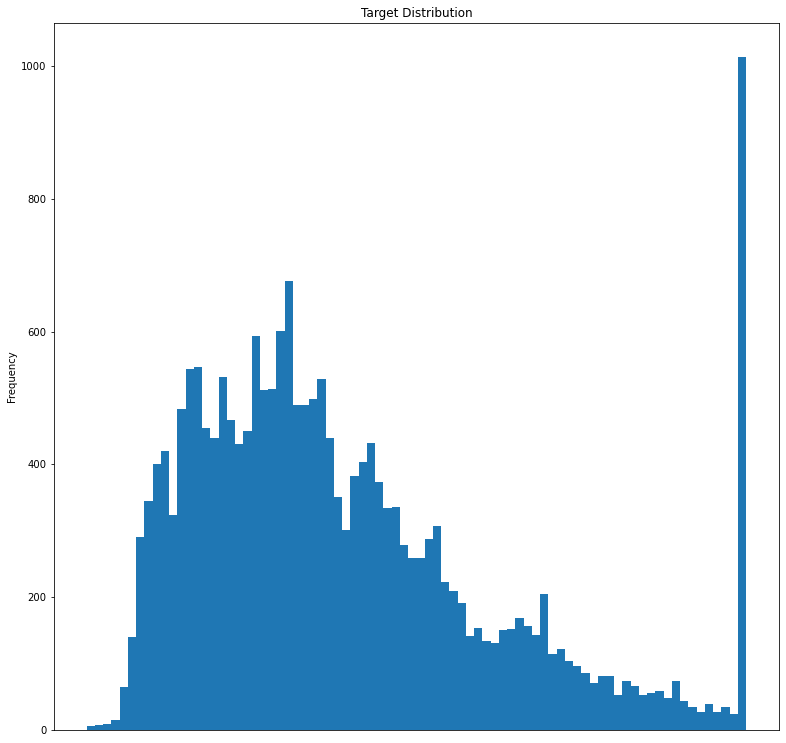

In [101]:
c_h.target.plot(kind='hist', 
                     bins=80,
                     title='Target Distribution',
                     xticks=range(20, 20, 20)
                )

In [59]:
c_h.target.describe()

count    20640.000000
mean         2.068558
std          1.153956
min          0.149990
25%          1.196000
50%          1.797000
75%          2.647250
max          5.000010
Name: MedHouseVal, dtype: float64

In [60]:
c_h.target.value_counts()

5.00001    965
1.37500    122
1.62500    117
1.12500    103
1.87500     93
          ... 
4.50800      1
0.32900      1
3.10100      1
3.26300      1
2.70400      1
Name: MedHouseVal, Length: 3842, dtype: int64

{'whiskers': [<matplotlib.lines.Line2D at 0x1838b084a90>,
 'caps': [<matplotlib.lines.Line2D at 0x1838b091190>,
 'boxes': [<matplotlib.lines.Line2D at 0x1838b084730>],
 'medians': [<matplotlib.lines.Line2D at 0x1838b091850>],
 'fliers': [<matplotlib.lines.Line2D at 0x1838b091bb0>],
 'means': []}

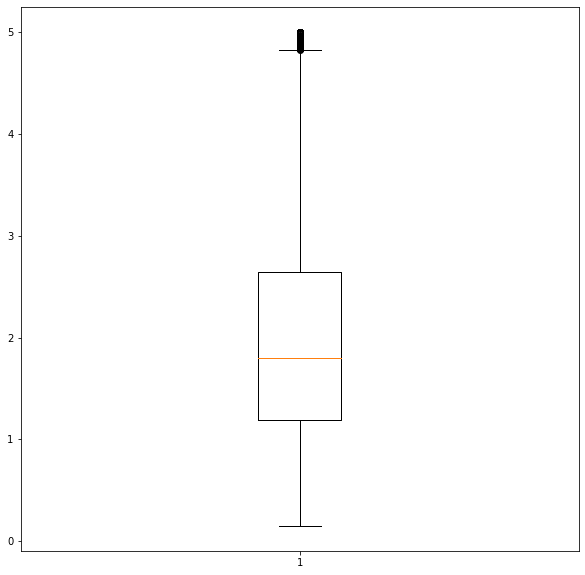

In [22]:
plt.boxplot(c_h.target)

выбросы присутствуют, что хорошо видно как из графиков, так и из данных от .describe() и .value_counts(). исходя из общего количества домов в выборке (20640) количество в 965 домов относящихся к 5 категории можно отнести именно к выбросу, хотя, вполне возможно, это просто отдельный фешенебельный район

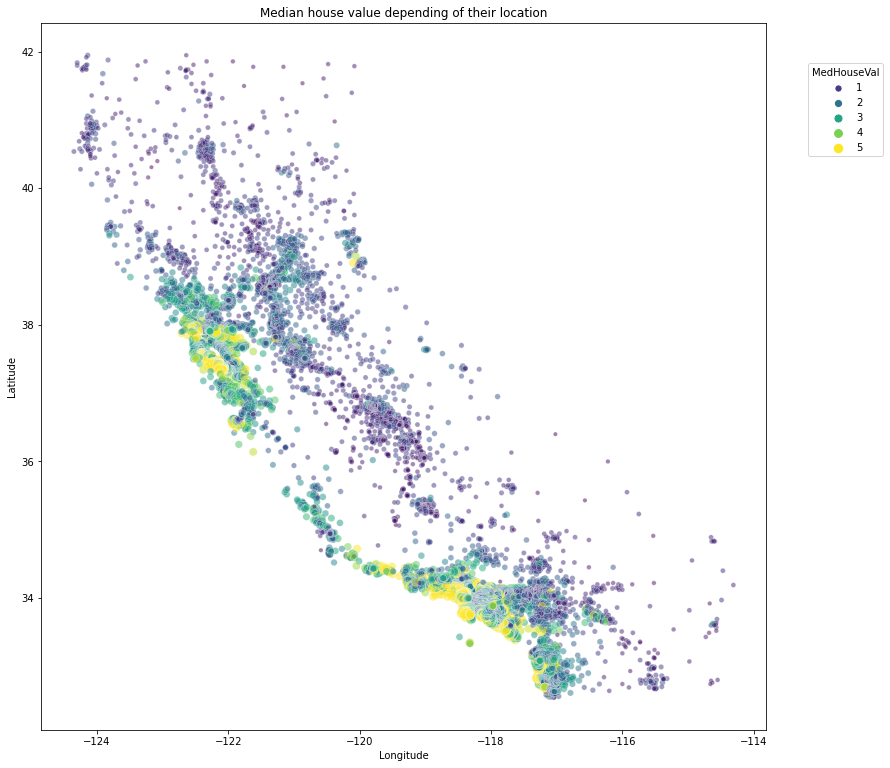

In [102]:
sns.scatterplot(data=c_h.frame, x="Longitude", y="Latitude",
                size="MedHouseVal", hue="MedHouseVal",
                palette="viridis", alpha=0.5)
plt.legend(title="MedHouseVal", bbox_to_anchor=(1.05, 0.95),
           loc="upper left")
_ = plt.title("Median house value depending of their location")

вышеприведенная точечная карта демонстрирует распределение, но, к сожалению, без привязки к реальным ГИС.
Попробуем повторить все то же на карте:

In [88]:
c_h.frame['color'] = np.where((c_h.frame['MedHouseVal'] < 1), '#000000', c_h.frame['color'])
c_h.frame['color'] = np.where((c_h.frame['MedHouseVal'] >= 1), '##001eff', c_h.frame['color'])
c_h.frame['color'] = np.where((c_h.frame['MedHouseVal'] >= 2), '##00ff7b', c_h.frame['color'])
c_h.frame['color'] = np.where((c_h.frame['MedHouseVal'] >= 3), '#008000', c_h.frame['color'])
c_h.frame['color'] = np.where((c_h.frame['MedHouseVal'] >= 4), '#fffb00', c_h.frame['color'])
c_h.frame['color'] = np.where((c_h.frame['MedHouseVal'] >= 5), '#ff0000', c_h.frame['color'])

In [90]:
c_h.frame['color'].unique()

array(['#fffb00', '#008000', '##00ff7b', '##001eff', '#000000', '#ff0000'],
      dtype=object)

In [93]:
# sns.heatmap(data=c_h.frame, annot=True)
import folium
this_map = folium.Map(prefer_canvas=True)
colors = ['red', 'blue']
def plotDot(point):
    
    folium.CircleMarker(
        location=[point.Latitude, point.Longitude],
        radius=2,
        weight=3,
        color=point.color,
        popup=point.MedHouseVal
    ).add_to(this_map)
    
c_h.frame.apply(plotDot, axis=1)
this_map.fit_bounds(this_map.get_bounds())

this_map

ну, первое, что бросается в глаза, это некоторый сдвиг в сторону океана. Видимо, проблема в самой карте, которая подгружается в folium, в результате чего некоторые дома просто в море. А вообще можно найти две зависимости:
 - квартиры/дома на побережье
 - квартиры/дома (возможно) на каких-то "правильных" улицах

#### 6. Посчитайте и выведите корреляционную матрицу. Убедитесь, что ячейки матрицы поделены на цветные категории, в ячейках указано числовое значение корреляции.
    a. Сделайте выводы.
    b. Удалите признаки на основании полученных значений, выводов.
    c. Повторите п. 3, п. 4 на измененных данных.

In [95]:
correlation_matrix = c_h.frame.corr().round(2)

<AxesSubplot:>

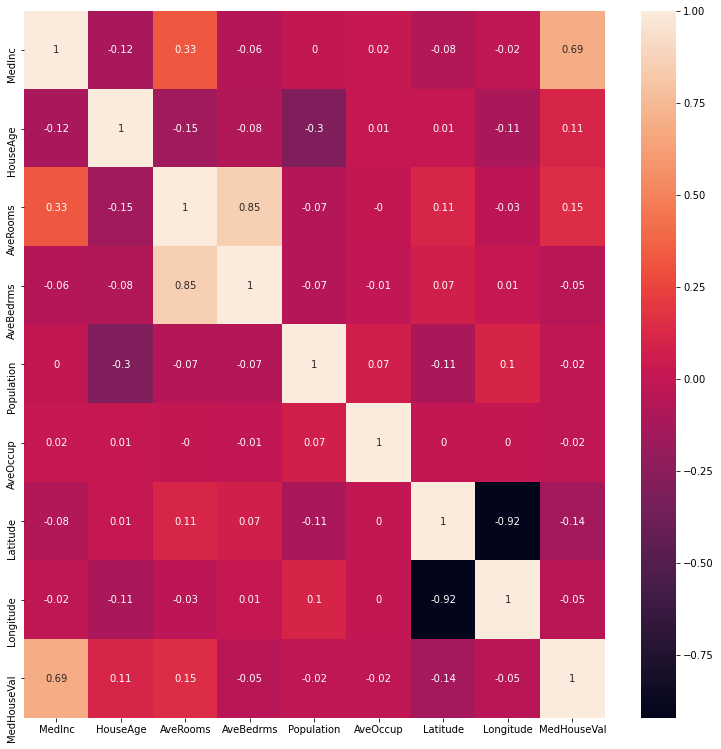

In [103]:
sns.heatmap(data=correlation_matrix, annot=True) # annot = True - для описания значений внутри квадратов

Имеет смысл выкинуть AveBedrms, Population и AveOccup, поскольку на удивление все они имеют отрицательную корреляцию с целевой переменной

In [191]:
X_n = c_h.data.drop(['AveBedrms', 'Population', 'AveOccup'], axis = 1)

In [192]:
X_n.head()

,MedInc,HouseAge,AveRooms,Latitude,Longitude
0,8.3252,41.0,6.984127,37.88,-122.23
1,8.3014,21.0,6.238137,37.86,-122.22
2,7.2574,52.0,8.288136,37.85,-122.24
3,5.6431,52.0,5.817352,37.85,-122.25
4,3.8462,52.0,6.281853,37.85,-122.25


In [198]:
Xx_train, Xx_test, yy_train, yy_test = train_test_split(X_n, Y, test_size=0.2, random_state=5)

In [199]:
model_n = LinearRegression()

In [200]:
model_n.fit(Xx_train, yy_train)
model_n.score(Xx_test, yy_test)

0.6083614590297953

ну, не то, чтобы стало сильно лучше (и это еще при том, что random state я поменял на более результативный)

In [153]:
n_predict_train = model_n.predict(Xx_train)
n_predict_test = model_n.predict(Xx_test)
n_predict = model_n.predict(X_n)

In [154]:
print('Для обучающей выборки:')
print('mse: ', mean_squared_error(yy_train, n_predict_train))
print('rmse: ', mean_squared_error(yy_train, n_predict_train, squared=False), '\n')
print('Для тестовой выборки:')
print('mse: ', mean_squared_error(yy_test, n_predict_test))
print('rmse: ', mean_squared_error(yy_test, n_predict_test, squared=False), '\n')
print('Для всей выборки:')
print('mse: ', mean_squared_error(Y, n_predict))
print('rmse: ', mean_squared_error(Y, n_predict, squared=False), '\n')

Для обучающей выборки:
mse:  0.537788658937069
rmse:  0.7333407522680496 

Для тестовой выборки:
mse:  0.5444131878384578
rmse:  0.7378436066257251 

Для всей выборки:
mse:  0.5391135647173468
rmse:  0.7342435322952098 



#### 8. Измените несколько признаков на выбор математически. Например, вычислите логарифм, возведите в квадрат, извлеките квадратный корень.
    a. Повторите п. 3, п. 4 на измененных данных.

In [196]:
X_n['root_age'] = [np.log2(i) for i in X_n['HouseAge']]
X_n['AveRooms'] = [i**2 for i in X_n['HouseAge']]

In [197]:
X_n.drop('HouseAge', axis=1).head()

,MedInc,AveRooms,Latitude,Longitude,root_age
0,8.3252,1681.0,37.88,-122.23,5.357552
1,8.3014,441.0,37.86,-122.22,4.392317
2,7.2574,2704.0,37.85,-122.24,5.700440
3,5.6431,2704.0,37.85,-122.25,5.700440
4,3.8462,2704.0,37.85,-122.25,5.700440


In [201]:
XX_train, XX_test, yY_train, yY_test = train_test_split(X_n, Y, test_size=0.2, random_state=5)

In [202]:
model_t = LinearRegression()

In [203]:
model_t.fit(XX_train, yY_train)
model_t.score(XX_test, yY_test)

0.6083614590297953

In [204]:
n_predict_train = model_n.predict(XX_train)
n_predict_test = model_n.predict(XX_test)
n_predict = model_n.predict(X_n)

In [205]:
print('Для обучающей выборки:')
print('mse: ', mean_squared_error(yy_train, n_predict_train))
print('rmse: ', mean_squared_error(yy_train, n_predict_train, squared=False), '\n')
print('Для тестовой выборки:')
print('mse: ', mean_squared_error(yy_test, n_predict_test))
print('rmse: ', mean_squared_error(yy_test, n_predict_test, squared=False), '\n')
print('Для всей выборки:')
print('mse: ', mean_squared_error(Y, n_predict))
print('rmse: ', mean_squared_error(Y, n_predict, squared=False), '\n')

Для обучающей выборки:
mse:  0.5362276810685883
rmse:  0.7322756865201714 

Для тестовой выборки:
mse:  0.5403374457031245
rmse:  0.7350764896955448 

Для всей выборки:
mse:  0.5370496339954954
rmse:  0.7328367034991461 



#### Выводы

Ну, в данном случае, математические преобразования помогли не сильно. Я предполагаю, что нужно в реальной задаче делать упор на работу с геоданными и как-то преобразовывать их. Например, уже озвученная мною удаленность от побережья, + выявление наиболее престижных улиц.